<a href="https://colab.research.google.com/github/NauaneLopes/Citologia_Oral/blob/main/EDA_Citologia_Oral.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Checagem e Histograma por Canal




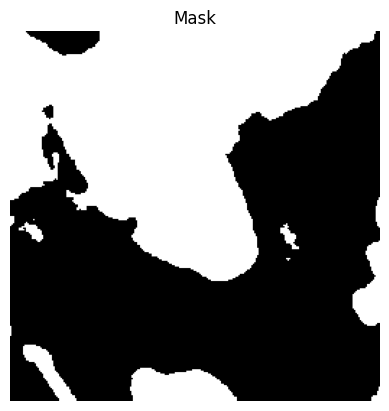

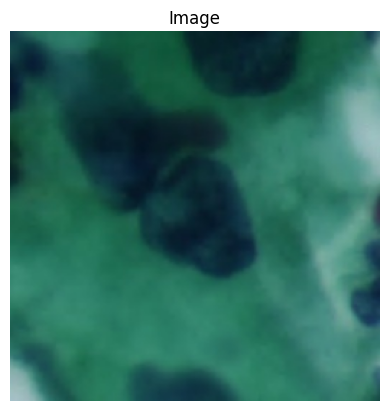

In [ ]:
# Checar se as máscaras estão identificando a parte necessária
# Carregar figura: center_0_2019_07_10__16_23__0048_b0s0c0x76363-1600y133912-1200m16917.png do conjunto val
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Ler imagem em RGB
img_path =  "/content/drive/MyDrive/RESULTADOS/mascaras_binarias_png/train/abnormal/center_6_2019_12_13__10_45__0038_b0s0c0x107200-1600y72000-1200m16867.png"
img_or = "/content/drive/MyDrive/RESULTADOS/nuclei_images_normalizadas_RGB/train/abnormal/center_6_2019_12_13__10_45__0038_b0s0c0x107200-1600y72000-1200m16867.jpg"
# Mascara
img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
# Imagem RGB
img_rgb = cv2.imread(img_or)

if img is not None:
    plt.imshow(img, cmap='gray')
    plt.title("Mask")
    plt.axis('off') # Hide axes
    plt.show()
else:
    print(f"Error loading mask image: {img_path}")
if img_rgb is not None:
    img_rgb = cv2.cvtColor(img_rgb, cv2.COLOR_BGR2RGB)
    plt.imshow(img_rgb)
    plt.title("Image")
    plt.axis('off') # Hide axes
    plt.show()
else:
    print(f"Error loading original image: {img_or}")

In [ ]:
import os
import cv2
import numpy as np
from tqdm import tqdm

# Caminho das máscaras segmentadas
caminho_mascaras =  "/content/drive/MyDrive/RESULTADOS/mascaras_binarias_png"
subsets = ['train', 'val', 'test']
classes = ['normal', 'abnormal']

def manter_maior_regiao(mascara_binaria):
    binaria = (mascara_binaria > 0).astype(np.uint8)
    num_labels, labels, stats, _ = cv2.connectedComponentsWithStats(binaria, connectivity=8)
    if num_labels <= 1:
        return mascara_binaria
    areas = stats[1:, cv2.CC_STAT_AREA]
    maior_indice = 1 + np.argmax(areas)
    resultado = (labels == maior_indice).astype(np.uint8) * 255
    return resultado.astype(np.uint8)

# Percorrer todas as máscaras
for subset in subsets:
    for classe in classes:
        pasta = os.path.join(caminho_mascaras, subset, classe)
        arquivos = [f for f in os.listdir(pasta) if f.endswith('.png')]

        for nome_arquivo in tqdm(arquivos, desc=f'Processando {subset}/{classe}'):
            caminho_img = os.path.join(pasta, nome_arquivo)

            # Carregar máscara
            mask = cv2.imread(caminho_img, cv2.IMREAD_GRAYSCALE)

            # Corrigir: manter só a maior região
            mask_corrigida = manter_maior_regiao(mask)

            # Salvar sobrescrevendo a anterior
            cv2.imwrite(caminho_img, mask_corrigida)


In [ ]:
# Extração de features:
import os
import cv2
import numpy as np
import pandas as pd
from skimage.measure import regionprops, label
from tqdm import tqdm

def extrair_features_morfologicas_mascara(mask, area_min=200):
    resultados = []
    labeled = label(mask)
    props = regionprops(labeled)

    unica_regiao = len(props) == 1

    for prop in props:
        # Se for a única região OU se área for maior que o mínimo, consideramos
        if unica_regiao or prop.area >= area_min:
            circ = (4 * np.pi * prop.area) / (prop.perimeter**2) if prop.perimeter > 0 else 0
            bbox_h = prop.bbox[2] - prop.bbox[0]
            bbox_w = prop.bbox[3] - prop.bbox[1]
            bbox_ratio = bbox_w / bbox_h if bbox_h > 0 else 0

            resultados.append({
                'area': prop.area,
                'perimetro': prop.perimeter,
                'circularidade': circ,
                'excentricidade': prop.eccentricity,
                'elongacao': prop.major_axis_length / prop.minor_axis_length if prop.minor_axis_length > 0 else 0,
                'compacidade': prop.area / (bbox_w * bbox_h) if bbox_w * bbox_h > 0 else 0,
                'bbox_ratio': bbox_ratio,
                'centroide_x': prop.centroid[0],
                'centroide_y': prop.centroid[1],
                'orientacao': prop.orientation,
                'euler_number': prop.euler_number
            })
    return resultados


# === CONFIGURAÇÕES ===
base_path = "/content/drive/MyDrive/RESULTADOS/mascaras_binarias_png"
subsets = ['train', 'val', 'test']
classes_desejadas = ['normal', 'abnormal']
area_min = 200

# === RESULTADO FINAL ===
todos_resultados = []

for subset in subsets:
    for classe in classes_desejadas:
        pasta_classe = os.path.join(base_path, subset, classe)
        if not os.path.exists(pasta_classe):
            continue

        for nome_arquivo in tqdm(os.listdir(pasta_classe), desc=f'{subset}/{classe}'):
            if nome_arquivo.lower().endswith(('.png', '.jpg', '.jpeg')):
                caminho = os.path.join(pasta_classe, nome_arquivo)
                mask = cv2.imread(caminho, cv2.IMREAD_GRAYSCALE)
                if mask is None:
                    continue
                # Binarizar caso necessário (assumindo que máscara é 0 e 255)
                bin_mask = (mask > 127).astype(np.uint8)
                features = extrair_features_morfologicas_mascara(bin_mask, area_min=area_min)
                for f in features:
                    f.update({
                        'nome_imagem': nome_arquivo,
                        'classe': classe,
                        'subset': subset
                    })
                    todos_resultados.append(f)

# Converter para DataFrame e salvar
df_final = pd.DataFrame(todos_resultados)
df_final.to_csv('/content/drive/MyDrive/RESULTADOS/features/features_morfologicas_normal_abnormal.csv', index=False)
print(" Extração finalizada. CSV salvo: features_morfologicas_normal_abnormal.csv")


test/abnormal: 100%|██████████| 3340/3340 [01:08<00:00, 48.73it/s]


 Extração finalizada. CSV salvo: features_morfologicas_normal_abnormal.csv


In [ ]:
import os
import cv2
import numpy as np
import pandas as pd
from tqdm import tqdm


# === CONFIGURAÇÕES ===
base_path =  "/content/drive/MyDrive/RESULTADOS/nuclei_images_normalizadas_RGB"
saida_path =  "/content/drive/MyDrive/RESULTADOS/EDA/histograma"
os.makedirs(saida_path, exist_ok=True)

subsets = ['train', 'val', 'test']
classes_desejadas = ['normal', 'abnormal']
bins = 256  # Resolução do histograma

def calcular_histograma_medio(caminhos_imgs):
    hist_r_total = np.zeros(bins)
    hist_g_total = np.zeros(bins)
    hist_b_total = np.zeros(bins)
    total_imgs = 0

    for path in tqdm(caminhos_imgs, desc='Calculando histogramas'):
        img = cv2.imread(path)
        if img is None:
            continue
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        chans = cv2.split(img)

        hist_r = cv2.calcHist([chans[0]], [0], None, [bins], [0, 256]).flatten()
        hist_g = cv2.calcHist([chans[1]], [0], None, [bins], [0, 256]).flatten()
        hist_b = cv2.calcHist([chans[2]], [0], None, [bins], [0, 256]).flatten()

        hist_r_total += hist_r
        hist_g_total += hist_g
        hist_b_total += hist_b
        total_imgs += 1

    if total_imgs == 0:
        return None

    return hist_r_total / total_imgs, hist_g_total / total_imgs, hist_b_total / total_imgs

# === PERCORRER CLASSES ===
for classe in classes_desejadas:
    caminhos_imgs = []
    for subset in subsets:
        pasta = os.path.join(base_path, subset, classe)
        if os.path.exists(pasta):
            arquivos = [os.path.join(pasta, f) for f in os.listdir(pasta) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
            caminhos_imgs.extend(arquivos)

    resultado = calcular_histograma_medio(caminhos_imgs)
    if resultado:
        hist_r, hist_g, hist_b = resultado
        df = pd.DataFrame({
            'Bin': np.arange(bins),
            'Canal_R': hist_r,
            'Canal_G': hist_g,
            'Canal_B': hist_b
        })
        df.to_csv(os.path.join(saida_path, f'{classe}_histograma_medio.csv'), index=False)
        print(f'Histograma médio salvo para classe {classe}')
    else:
        print(f'Nenhuma imagem válida para a classe {classe}')


Calculando histogramas: 100%|██████████| 8286/8286 [33:38<00:00,  4.11it/s]


Histograma médio salvo para classe normal


Calculando histogramas:  82%|████████▏ | 18601/22739 [4:08:36<53:49,  1.28it/s]  

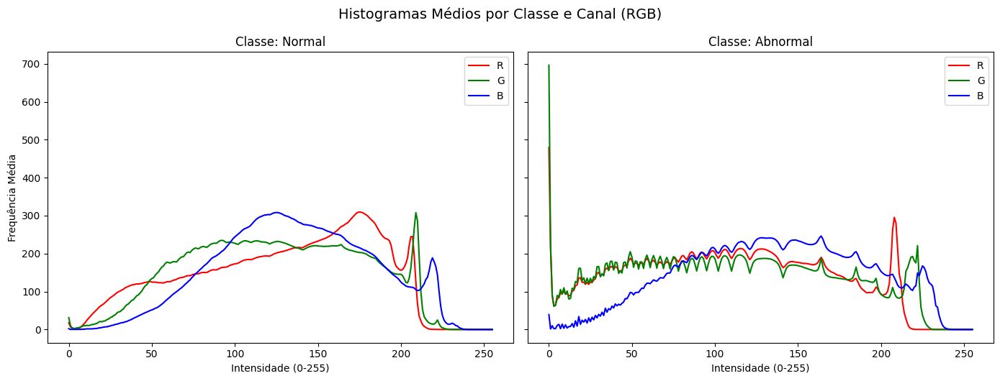

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import os

# Caminho para os arquivos CSV já extraídos com histogramas médios
normal_csv = "/content/drive/MyDrive/RESULTADOS/EDA/histograma/normal_histograma_medio.csv"
abnormal_csv = "/content/drive/MyDrive/RESULTADOS/EDA/histograma/abnormal_histograma_medio.csv"

# Carregar os dados
df_normal = pd.read_csv(normal_csv)
df_abnormal = pd.read_csv(abnormal_csv)

# Criar subplots: 1 linha, 2 colunas (normal e abnormal)
fig, axes = plt.subplots(1, 2, figsize=(14, 5), sharey=True)

# === Classe NORMAL ===
axes[0].plot(df_normal['Bin'], df_normal['Canal_R'], color='red', label='R')
axes[0].plot(df_normal['Bin'], df_normal['Canal_G'], color='green', label='G')
axes[0].plot(df_normal['Bin'], df_normal['Canal_B'], color='blue', label='B')
axes[0].set_title('Classe: Normal')
axes[0].set_xlabel('Intensidade (0-255)')
axes[0].set_ylabel('Frequência Média')
axes[0].legend()

# === Classe ABNORMAL ===
axes[1].plot(df_abnormal['Bin'], df_abnormal['Canal_R'], color='red', label='R')
axes[1].plot(df_abnormal['Bin'], df_abnormal['Canal_G'], color='green', label='G')
axes[1].plot(df_abnormal['Bin'], df_abnormal['Canal_B'], color='blue', label='B')
axes[1].set_title('Classe: Abnormal')
axes[1].set_xlabel('Intensidade (0-255)')
axes[1].legend()

plt.tight_layout()
plt.suptitle('Histogramas Médios por Classe e Canal (RGB)', y=1.05, fontsize=14)
plt.show()


In [ ]:
import os
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from plotly.offline import plot

# Criar a pasta no Drive
output_folder = '/content/drive/MyDrive/RESULTADOS/HISTOGRAMAS_RGB'
os.makedirs(output_folder, exist_ok=True)

# === Dados (assumindo df_normal e df_abnormal já carregados) ===
df_normal['classe'] = 'normal'
df_abnormal['classe'] = 'abnormal'
df = pd.concat([df_normal, df_abnormal], ignore_index=True)
df_long = pd.melt(df, id_vars=['Bin', 'classe'], value_vars=['Canal_R', 'Canal_G', 'Canal_B'],
                  var_name='canal', value_name='frequencia')
df_long['canal'] = df_long['canal'].str.replace('Canal_', '')
df_long.rename(columns={'Bin': 'bins'}, inplace=True)

# Criar o painel de histogramas
fig = make_subplots(rows=2, cols=3,
                    subplot_titles=[
                        "Normal - Canal R", "Normal - Canal G", "Normal - Canal B",
                        "Abnormal - Canal R", "Abnormal - Canal G", "Abnormal - Canal B"
                    ])
cores_canais = {'R': 'red', 'G': 'green', 'B': 'blue'}
classes = ['normal', 'abnormal']
canais = ['R', 'G', 'B']

for row_idx, classe in enumerate(classes, start=1):
    for col_idx, canal in enumerate(canais, start=1):
        df_sub = df_long[(df_long['classe'] == classe) & (df_long['canal'] == canal)]
        fig.add_trace(
            go.Bar(
                x=df_sub['bins'],
                y=df_sub['frequencia'],
                marker=dict(color=cores_canais[canal]),
                showlegend=False
            ),
            row=row_idx, col=col_idx
        )

fig.update_layout(
    title_text="Histograma RGB por Classe e Canal",
    width=1100,
    height=700,
    bargap=0.1
)

for i in range(1, 7):
    fig.update_xaxes(title_text="Intensidade (0-255)", row=(i-1)//3 +1, col=((i-1)%3)+1)
    fig.update_yaxes(title_text="Frequência", row=(i-1)//3 +1, col=((i-1)%3)+1)

fig.show()

# === Salvar como HTML no Drive ===
output_file = os.path.join(output_folder, 'histograma_rgb_painel.html')
plot(fig, filename=output_file, auto_open=False)
print(f"Gráfico HTML salvo em: {output_file}")


Gráfico HTML salvo em: /content/drive/MyDrive/RESULTADOS/HISTOGRAMAS_RGB/histograma_rgb_painel.html


Observa-se que os núcleos classificados como normais apresentaram distribuições espectrais mais suaves e concentradas, principalmente nos canais azul e verde. Por outro lado, as imagens da classe anormal evidenciaram maior dispersão e intensidade nos mesmos canais, com destaque para o canal verde. Essa variação espectral pode estar associada à presença de alterações morfológicas e estruturais típicas de lesões atípicas.

In [ ]:
print("Colunas df_normal:", df_normal.columns)
print("Colunas df_abnormal:", df_abnormal.columns)

Colunas df_normal: Index(['Bin', 'Canal_R', 'Canal_G', 'Canal_B', 'classe'], dtype='object')
Colunas df_abnormal: Index(['Bin', 'Canal_R', 'Canal_G', 'Canal_B', 'classe'], dtype='object')


# EDA - features morfológicas

In [ ]:
import pandas as pd
df = pd.read_csv("/content/drive/MyDrive/RESULTADOS/EDA/features/f_morfologicas_normal_abnormal.csv")
df.shape

(45911, 14)

In [ ]:
# area por conjunto de dados e classes
fig_area = px.box(
    df,
    x='classe',
    y='area',
    color='classe',
    facet_col='subset',
    color_discrete_map={'normal': 'skyblue', 'abnormal': 'lightcoral'},
    title='Distribuição da Área por Classe e Subset',
    points='outliers',
    height=500,
    width=1000
)
fig_area.update_layout(showlegend=False, boxmode='group')
fig_area.show()


In [ ]:
import matplotlib.pyplot as plt
# Salvar estatísticas descritivas como CSV
df.describe().to_csv("estat_morf.csv", index=True)
# Gerar estatísticas descritivas e transpor para deixar variáveis nas linhas
tabela_latex = df.describe().round(3)

# Salvar como arquivo LaTeX
with open("estat_morf.tex", "w") as f:
    f.write(tabela_latex.to_latex(
        float_format="%.3f",
        caption="Estatísticas descritivas das variáveis morfométricas.",
        label="tab:estat_morf"
    ))

In [ ]:
df.columns

Index(['area', 'perimetro', 'circularidade', 'excentricidade', 'elongacao',
       'compacidade', 'bbox_ratio', 'centroide_x', 'centroide_y', 'orientacao',
       'euler_number', 'nome_imagem', 'classe', 'subset'],
      dtype='object')

In [ ]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
area,45911.0,12018.341509,15110.821488,200.000000,1575.500000,3865.000000,21545.500000,63807.000000
perimetro,45911.0,528.402484,489.854046,49.798990,173.539105,284.403066,892.411255,3889.275575
circularidade,45911.0,0.520708,0.229403,0.026497,0.324331,0.518783,0.730136,1.020252
excentricidade,45911.0,0.724656,0.161078,0.052643,0.626822,0.746163,0.846325,0.998812
elongacao,45911.0,1.752927,0.889327,1.001389,1.283429,1.502035,1.877344,20.518581
compacidade,45911.0,0.668606,0.129203,0.124150,0.583681,0.690864,0.766493,0.986271
bbox_ratio,45911.0,1.129188,0.630787,0.075676,0.828125,1.000000,1.252476,14.000000
centroide_x,45911.0,96.621433,69.119782,1.491379,34.458421,83.705234,143.545416,253.341637
centroide_y,45911.0,96.598376,68.774914,1.978648,34.122697,85.221498,143.788463,253.609649
orientacao,45911.0,0.006324,0.940481,-1.570784,-0.813738,0.007689,0.827932,1.570791


Essas estatísticas descritivas revelam grande variabilidade morfométrica entre as regiões segmentadas. E por meio dessas informações nota-se que, a distribuição da área e do perímetro é assimétrica, com valores máximos que indicam a presença de possíveis outliers (células grandes ou agrupadas). A circularidade e compacidade sugerem uma predominância de formas moderadamente regulares, enquanto métricas como excentricidade e elongação apontam para núcleos com diferentes graus de alongamento.


In [ ]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Cores fixas para as classes
classes = ['normal', 'abnormal']
cores_classes = {'normal': '#D2691E', 'abnormal': '#4169E1'}  # Dark Orange e Royal Blue

# Criar a figura com 1 linha e 2 colunas
fig = make_subplots(
    rows=1, cols=2,
    subplot_titles=("Distribuição da Área por Classe", "Distribuição do Perímetro por Classe")
)

# === Gráfico da Área (coluna 1) ===
for classe in classes:
    fig.add_trace(
        go.Violin(
            y=df[df['classe'] == classe]['area'],
            x=[classe] * len(df[df['classe'] == classe]),
            name=f"{classe.capitalize()} (Área)",
            box_visible=True,
            meanline_visible=True,
            line_color='black',
            fillcolor=cores_classes[classe],
            opacity=0.6,
            points=False,
            showlegend=False
        ),
        row=1, col=1
    )

# === Gráfico do Perímetro (coluna 2) ===
for classe in classes:
    fig.add_trace(
        go.Violin(
            y=df[df['classe'] == classe]['perimetro'],
            x=[classe] * len(df[df['classe'] == classe]),
            name=f"{classe.capitalize()} (Perímetro)",
            box_visible=True,
            meanline_visible=True,
            line_color='black',
            fillcolor=cores_classes[classe],
            opacity=0.6,
            points=False,
            showlegend=False
        ),
        row=1, col=2
    )

# Ajustes de layout geral
fig.update_layout(
    width=1200,
    height=600,
    font=dict(size=14),
    plot_bgcolor='white',
    title_text="Comparativo: Área vs Perímetro por Classe",
)

# Ajuste de eixos
fig.update_yaxes(title_text="Área (pixels)", row=1, col=1)
fig.update_yaxes(title_text="Perímetro (pixels)", row=1, col=2)

fig.show()


Por meio desse gráfico violinplot combinado com boxplot pode-se perceber por meio desses gráficos que embora ambos apresentem assimetria à direita e outliers extremos, a classe anormal apresentou maior concentração de núcleos com áreas pequenas, mas também mais dispersão para valores altos, refletindo maior heterogeneidade morfológica. Já os núcleos normais mostraram distribuição mais concentrada, com áreas medianas ligeiramente maiores e menor frequência de valores extremos. Esses dados reforçam o que foi apresentado nas estatísticas descritivas. E variável perímetro apresenta comportamento muito semelhante entre as classes normal e anormal, com valores médios e máximos quase idênticos. Contudo, ambas as classes mostram assimetrias à direita e alta dispersão, com presença marcante de outliers. Isso indica que, embora o perímetro médio não diferencie as classes diretamente, a variabilidade e os extremos podem estar associados a alterações estruturais mais sutis, comuns em células anormais.

In [ ]:
import pandas as pd
import numpy as np

# Classes no dataset
classes = df['classe'].unique()
classes.sort()

# Lista para armazenar os resultados
estatisticas = []

for classe in classes:
    dados = df[df['classe'] == classe]['area'].values

    q1 = np.percentile(dados, 25)
    q2 = np.percentile(dados, 50)
    q3 = np.percentile(dados, 75)
    iqr = q3 - q1
    mean = np.mean(dados)
    min_val = np.min(dados)
    max_val = np.max(dados)
    upper_fence = q3 + 1.5 * iqr
    lower_fence = q1 - 1.5 * iqr

    estatisticas.append({
        'Classe': classe,
        'Min': round(min_val, 2),
        'Q1 (25%)': round(q1, 2),
        'Mediana (Q2)': round(q2, 2),
        'Média': round(mean, 2),
        'Q3 (75%)': round(q3, 2),
        'Max': round(max_val, 2),
        'Limite inferior': round(lower_fence, 2),
        'Limite superior': round(upper_fence, 2)
    })

# Criar DataFrame com os resultados
df_estatisticas = pd.DataFrame(estatisticas)

# Exportar para LaTeX
with open("tabela_estatisticas_area.tex", "w") as f:
    f.write(df_estatisticas.to_latex(index=False,
                                     caption="Estatísticas descritivas da variável área por classe.",
                                     label="tab:estatisticas_area",
                                     float_format="%.1f"))

In [ ]:
import pandas as pd
import numpy as np

# Classes no dataset
classes = df['classe'].unique()
classes.sort()

# Lista para armazenar os resultados
estatisticas = []

for classe in classes:
    dados = df[df['classe'] == classe]['perimetro'].values

    q1 = np.percentile(dados, 25)
    q2 = np.percentile(dados, 50)
    q3 = np.percentile(dados, 75)
    iqr = q3 - q1
    mean = np.mean(dados)
    min_val = np.min(dados)
    max_val = np.max(dados)
    upper_fence = q3 + 1.5 * iqr
    lower_fence = q1 - 1.5 * iqr

    estatisticas.append({
        'Classe': classe,
        'Min': round(min_val, 2),
        'Q1 (25%)': round(q1, 2),
        'Mediana (Q2)': round(q2, 2),
        'Média': round(mean, 2),
        'Q3 (75%)': round(q3, 2),
        'Max': round(max_val, 2),
        'Limite inferior': round(lower_fence, 2),
        'Limite superior': round(upper_fence, 2)
    })

# Criar DataFrame com os resultados
df_estatisticas = pd.DataFrame(estatisticas)

# Exportar para LaTeX
with open("tabela_estatisticas_perimetro.tex", "w") as f:
    f.write(df_estatisticas.to_latex(index=False,
                                     caption="Estatísticas descritivas da variável perímetro por classe.",
                                     label="tab:estatisticas_perimetro",
                                     float_format="%.1f"))

In [ ]:
import numpy as np
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from scipy.stats import gaussian_kde

# Variáveis e classes
variaveis = ['compacidade', 'elongacao']
titulos = ['Compacidade', 'Elongação']
cores = {'normal': 'skyblue', 'abnormal': 'lightcoral'}
classes = df['classe'].unique()

# Subplots lado a lado
fig = make_subplots(rows=1, cols=2, subplot_titles=titulos)

for classe in classes:
    for i, var in enumerate(variaveis):
        dados = df[df['classe'] == classe][var].dropna()

        # Calcular densidade (KDE)
        kde = gaussian_kde(dados)
        x_vals = np.linspace(dados.min(), dados.max(), 500)
        y_vals = kde(x_vals)

        # Adicionar curva
        fig.add_trace(
            go.Scatter(
                x=x_vals,
                y=y_vals,
                mode='lines',
                name=classe,
                legendgroup=classe,  # Permite controle da legenda em ambos os subplots
                line=dict(color=cores[classe]),
                fill='tozeroy',
                opacity=0.4,
                showlegend=(i == 0)  # Mostrar legenda apenas no primeiro subplot
            ),
            row=1, col=i+1
        )

# Layout final
fig.update_layout(
    title_text="Distribuição de Densidade (KDE) - Compacidade e Elongação por Classe",
    width=1000,
    height=400
)

fig.update_xaxes(title_text='Compacidade', row=1, col=1)
fig.update_xaxes(title_text='Elongação', row=1, col=2)
fig.update_yaxes(title_text='Densidade', row=1, col=1)
fig.update_yaxes(title_text='Densidade', row=1, col=2)

fig.show()


In [ ]:
import numpy as np
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from scipy.stats import gaussian_kde

# Variáveis e classes
variaveis = ['compacidade', 'elongacao']
titulos = ['Compacidade', 'Elongação']
cores = {'normal': '#D2691E', 'abnormal': '#4169E1'}
classes = df['classe'].unique()

# Criar subplots lado a lado
fig = make_subplots(rows=1, cols=2, subplot_titles=titulos)

# Adicionar curvas preenchidas + linhas de média + box de anotação
for classe in classes:
    for i, var in enumerate(variaveis):
        dados = df[df['classe'] == classe][var].dropna()
        kde = gaussian_kde(dados)
        x_vals = np.linspace(dados.min(), dados.max(), 500)
        y_vals = kde(x_vals)
        media = dados.mean()

        # Curva com preenchimento
        fig.add_trace(
            go.Scatter(
                x=x_vals,
                y=y_vals,
                mode='lines',
                name=classe,
                legendgroup=classe,
                fill='tozeroy',
                line=dict(color=cores[classe]),
                opacity=0.4,
                showlegend=(i == 0)
            ),
            row=1, col=i+1
        )

        # Linha de média tracejada
        fig.add_trace(
            go.Scatter(
                x=[media, media],
                y=[0, max(y_vals)],
                mode='lines',
                line=dict(color=cores[classe], dash='dash'),
                showlegend=False,
                hoverinfo='skip'
            ),
            row=1, col=i+1
        )

        # Anotação com caixa
        fig.add_annotation(
            x=media,
            y=max(y_vals) * 0.95,
            xref=f"x{i+1}",
            yref=f"y{i+1}",
            text=f"Média: {media:.2f}",
            showarrow=False,
            font=dict(color='white'),
            bgcolor=cores[classe],
            bordercolor='black',
            borderwidth=1,
            align='center',
            opacity=0.8
        )

# Layout final
fig.update_layout(
    title_text="Distribuição de Densidade (KDE) - Compacidade e Elongação por Classe",
    width=800,
    height=400
)

fig.update_xaxes(title_text='Compacidade', row=1, col=1)
fig.update_xaxes(title_text='Elongação', row=1, col=2)
fig.update_yaxes(title_text='Densidade', row=1, col=1)
fig.update_yaxes(title_text='Densidade', row=1, col=2)

fig.show()

Para análise complementar, foi plotado outras variáveis em duplas como compacidade e elongação. Essas variáveis indicam que células normais são mais compactas e arredondadas, enquanto células anormais apresentam formas mais variadas e ligeiramente mais alongadas.

In [ ]:
import plotly.express as px

# Apenas os dados de interesse
df_densidade = df[['circularidade', 'excentricidade', 'classe']].dropna()

# Criar gráfico com facet por classe
fig = px.density_contour(
    df_densidade,
    x="excentricidade",
    y="circularidade",
    color="classe",
    facet_col="classe",
    marginal_x="histogram",
    marginal_y="histogram",
    title="Distribuição 2D: Circularidade vs Excentricidade por Classe",
    height=500,
    width=1000
)

# Ajustar apenas as traces de contorno
fig.update_traces(selector=dict(type='contour'), contours_coloring="fill", opacity=0.6, showlegend=False)

# Ajustes visuais
fig.update_xaxes(matches=None, title='Excentricidade')
fig.update_yaxes(matches=None, title='Circularidade')
fig.update_layout(coloraxis_showscale=False)

fig.show()

Para circularidade e excentricidade, o plot acima revela que, para a classe normal, apresentou concentração de núcleos com alta circularidade e excentricidade moderada, refletindo contornos regulares. Já a classe anormal apresentou distribuição mais difusa, com menor circularidade e maior variação na excentricidade, indicando alterações estruturais típicas de células com atipias morfológicas.

In [ ]:
# 'bbox_ratio', 'centroide_x', 'centroide_y'

import plotly.graph_objects as go
from plotly.subplots import make_subplots

variaveis = ['bbox_ratio', 'centroide_x', 'centroide_y']
cores = {'normal': '#D2691E', 'abnormal': '#4169E1'}  # Dark Orange e Royal Blue
classes = df['classe'].unique()

# Subplots: 2 linhas (boxplot + histograma) e 3 colunas (variáveis)
fig = make_subplots(
    rows=2, cols=3,
    shared_xaxes=False,
    shared_yaxes='rows',
    row_heights=[0.3, 0.7],
    vertical_spacing=0.05,
    subplot_titles=[v.replace('_', ' ').capitalize() for v in variaveis]
)

# Plotagem
for i, var in enumerate(variaveis):
    for classe in classes:
        dados = df[df['classe'] == classe][var].dropna()

        # Boxplot (linha de cima)
        fig.add_trace(
            go.Box(
                x=dados,
                name=classe,
                marker_color=cores.get(classe, 'gray'),
                boxpoints=False,
                orientation='h',
                showlegend=(i == 0),  # mostrar legenda apenas na primeira coluna
                legendgroup=classe  # permite que a legenda filtre todas as colunas
            ),
            row=1, col=i+1
        )

        # Histograma (linha de baixo)
        fig.add_trace(
            go.Histogram(
                x=dados,
                name=classe,
                marker_color=cores.get(classe, 'gray'),
                opacity=0.6,
                nbinsx=50,
                showlegend=False,
                legendgroup=classe
            ),
            row=2, col=i+1
        )

# Layout final
fig.update_layout(
    height=500,
    width=1200,
    title_text="Distribuição das Variáveis bbox_ratio, centroide_x e centroide_y por Classe",
    barmode='overlay',
    legend_title="Classe"
)

# Eixos
for i, var in enumerate(variaveis):
    fig.update_xaxes(title_text=var.replace('_', ' ').capitalize(), row=2, col=i+1)
fig.update_yaxes(title_text="Frequência", row=2)

fig.show()


O plot apresenta a forma em que as variáveis bbbox\_ratio, x\_centroide e y\_centroide estão distribuídos. Ao analisar o comportamento dessas variáveis, por meio dos gráficos, nota-se que as células anormais tendem a ter bounding boxes mais assimétricas (formas mais alongadas ou inclinadas), enquanto as normais têm proporções mais regulares, pode ser percebido quando se analisa o histograma, e os Whiskers (boxplot) tando para normal como para anormal estão mais alongados, mais presente para núcleos anormais, o que indica maior variabilidade dos dados e outliers em que o valor máximo é 14. Em relação as variáveis centroide em x e centroide em y, apresentam distribuição bem similar, para a centroide em x a posição horizontal dos núcleos anormais tende a ser mais dispersa, possivelmente por serem mais numerosos ou por agrupamentos menos simétricos. Centroide em y possui um comportamento semelhante, em que localização vertical também confirma que núcleos anormais aparecem em regiões mais variadas da imagem, indicando maior irregularidade ou dispersão. Assim, a distribuição mais ampla e a assimetria das variáveis em anormal reforçam a heterogeneidade morfológica e espacial dos núcleos com alteração. Isso pode ser um forte sinal discriminativo para modelos de classificação, inclusive auxiliando em pré-processamentos.

In [ ]:
import pandas as pd
import numpy as np

# Variáveis que serão analisadas
variaveis = ['bbox_ratio', 'centroide_x', 'centroide_y']
classes = df['classe'].unique()

# Lista para armazenar os resultados
estatisticas = []

# Loop por classe e variável
for var in variaveis:
    for classe in classes:
        dados = df[df['classe'] == classe][var].dropna()

        estatisticas.append({
            'Variável': var,
            'Classe': classe,
            'Mín': round(np.min(dados), 2),
            'Q1': round(np.percentile(dados, 25), 2),
            'Mediana': round(np.median(dados), 2),
            'Média': round(np.mean(dados), 2),
            'Q3': round(np.percentile(dados, 75), 2),
            'Máx': round(np.max(dados), 2),
            'Desvio Padrão': round(np.std(dados), 2)
        })

# Criar DataFrame da tabela
df_estat = pd.DataFrame(estatisticas)

# Exportar para LaTeX
with open("tabela_estat_bbox_centroides.tex", "w") as f:
    f.write(df_estat.to_latex(index=False,
                               caption="Estatísticas descritivas das variáveis bbox_ratio, centroide_x e centroide_y por classe.",
                               label="tab:estat_bbox_centroides",
                               float_format="%.2f"))


# EDA - features de intensidade de coloração

In [ ]:
df_ie = pd.read_csv("/content/drive/MyDrive/RESULTADOS/EDA/features/f_esp_correta.csv")
df_ie.shape

(65521, 121)

In [ ]:
# localizar colunas que possuem nome com _hist_bin_ em qualquer parte
df_ie.filter(regex='_hist_bin_').columns

# Excluir colunas que contenha _hist_bin_
df_ie = df_ie.drop(df_ie.filter(regex='_hist_bin_').columns, axis=1)
df_ie.shape

(65521, 25)

In [ ]:
# Filtrar df para normal e abnormal
df_filt = df_ie[df_ie['classe'].isin(['normal', 'abnormal'])]
df_filt.shape

(31025, 25)

In [ ]:
df_filt.columns

Index(['conjunto', 'classe', 'nome_imagem', 'R_media', 'R_mediana', 'R_moda',
       'R_desvio', 'R_min', 'R_max', 'G_media', 'G_mediana', 'G_moda',
       'G_desvio', 'G_min', 'G_max', 'B_media', 'B_mediana', 'B_moda',
       'B_desvio', 'B_min', 'B_max', 'R_div_B', 'G_div_B', 'R_div_G',
       'RG_div_2B'],
      dtype='object')

In [ ]:
import plotly.express as px

df_box = df_filt.melt(
    id_vars='classe',
    value_vars=['R_media', 'R_mediana', 'R_moda', 'R_desvio', 'R_min', 'R_max'],
    var_name='Estatística',
    value_name='Valor'
)

fig = px.box(df_box, x='Estatística', y='Valor', color='classe', boxmode='group',
             title='Boxplot — Estatísticas do Canal R por Classe')
fig.update_layout(xaxis_title='Estatísticas de Intensidade de Coloração', yaxis_title='Valor')
fig.show()


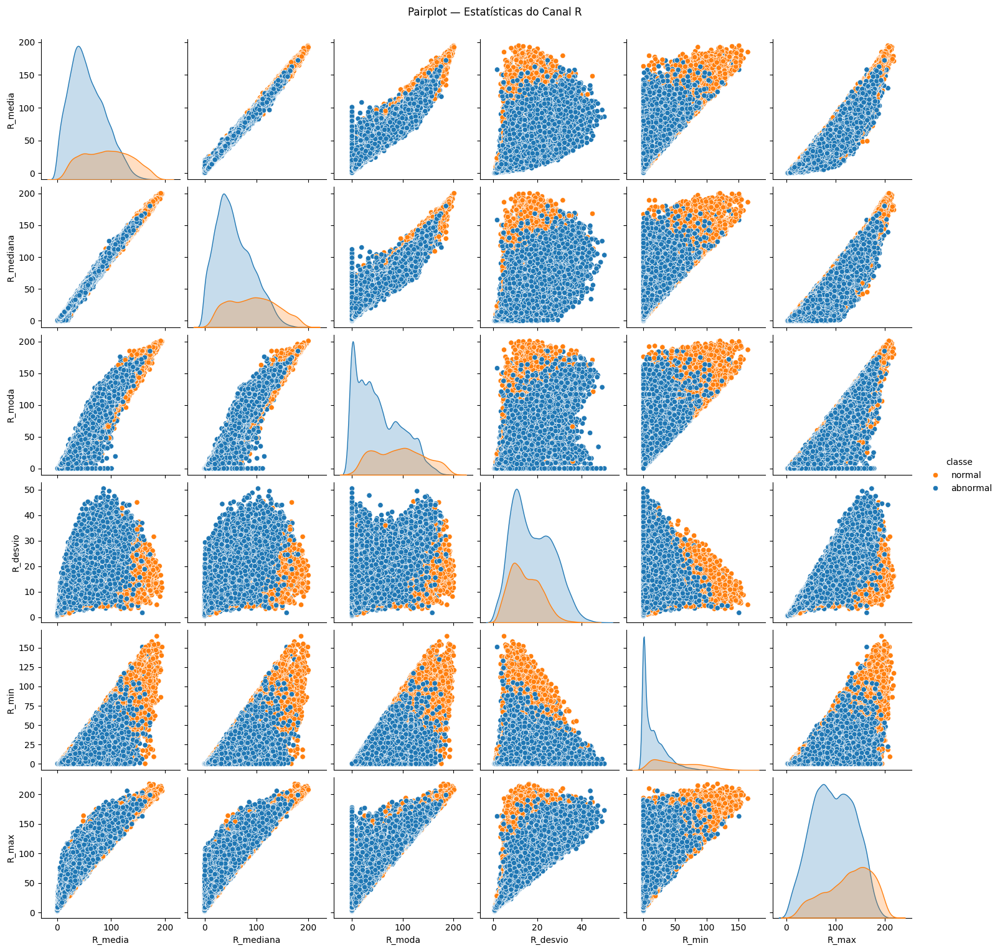

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Define cores personalizadas
palette = {
    "abnormal": "#1f77b4",  # azul
    "normal": "#ff7f0e"     # laranja
}

# Pairplot com cores invertidas
s= sns.pairplot(
    df_filt,
    vars=['R_media', 'R_mediana', 'R_moda', 'R_desvio', 'R_min', 'R_max'],
    hue='classe',
    palette=palette
)

plt.suptitle("Pairplot — Estatísticas do Canal R", y=1.02)
plt.show()


# Salvar como PNG
s.fig.savefig("pairplot_canal_R.png", dpi=300, bbox_inches='tight')

A Figura presenta a distribuição e o comportamento dos valores extraídos para o canal R (vermelho). Os gráficos de dispersão cruzada indicam que a classe anormal apresenta intensidade mais elevada em todas as métricas de tendência central (média, mediana, moda) e também nos extremos (mínimo e máximo), sugerindo que essas células são globalmente mais brilhantes no canal vermelho. A classe normal, por outro lado, está mais concentrada de valores baixos a médios, com maior variabilidade relativa no desvio padrão. Embora, a classe anormal apresente valores absolutos mais altos de desvio padrão, seus pontos estão mais concentrados, o que indica menor dispersão intraclasse. Já a classe normal tem pontos espalhados ao longo do eixo de desvio, refletindo heterogeneidade maior entre amostras.

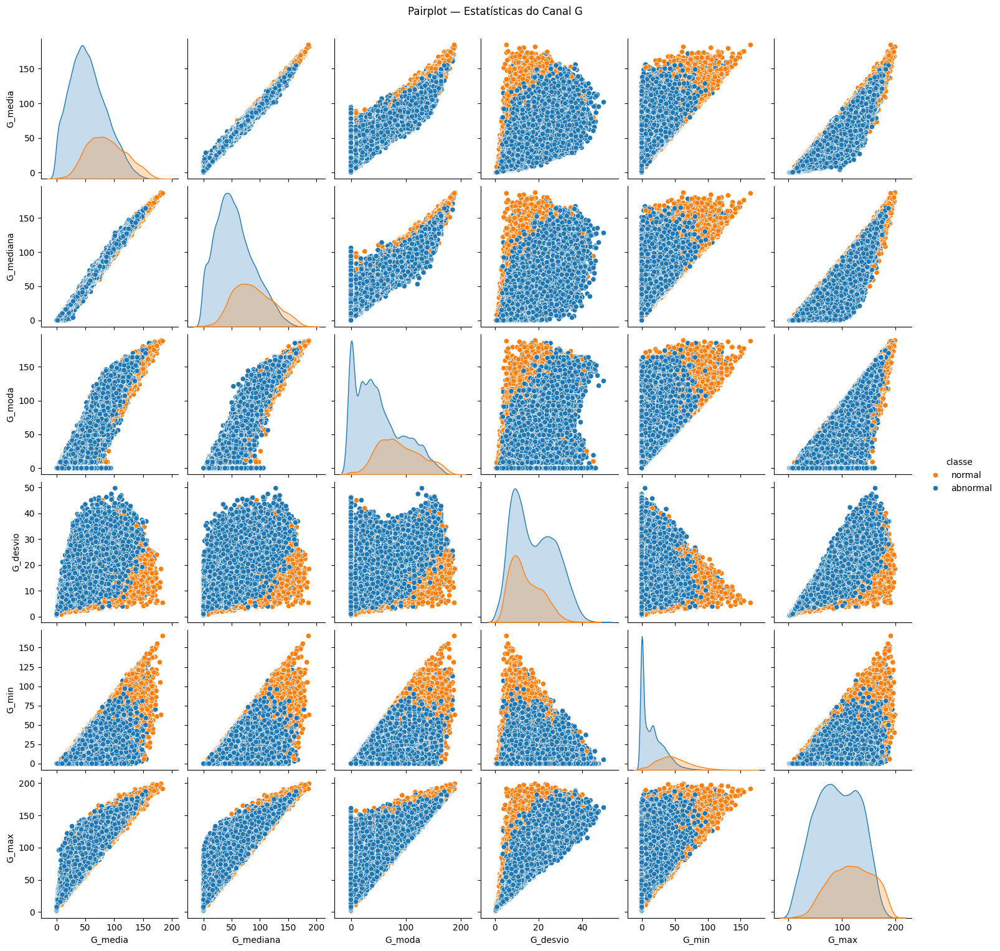

In [ ]:
# Define cores personalizadas
palette = {
    "abnormal": "#1f77b4",  # azul
    "normal": "#ff7f0e"     # laranja
}

# Pairplot com cores invertidas
r = sns.pairplot(
    df_filt,
    vars=['G_media', 'G_mediana', 'G_moda', 'G_desvio', 'G_min', 'G_max'],
    hue='classe',
    palette=palette
)

plt.suptitle("Pairplot — Estatísticas do Canal G", y=1.02)
plt.show()


# Salvar como PNG
r.fig.savefig("pairplot_canal_G.png", dpi=300, bbox_inches='tight')

 Ao analisar o pairplot referente ao canal G, as distribuições das estatísticas mostram diferenças relevantes entre as classes, porém com alta sobreposição nos pares de dispersão. A classe normal tende a apresentar distribuições mais concentradas e unicaudais, enquanto a classe anormal exibe distribuições mais amplas, com indícios de bicaudalidade ou multimodalidade em variáveis como moda, mínimo, máximo e desvio padão. O desequilíbrio de dados pode influenciar visualmente essas conclusões, uma vez que a maior quantidade de exemplos da classe anormal amplia a cauda e evidencia variações internas. Ainda assim, as tendências observadas sugerem que normal é mais restrita em intensidade e variação no canal G, ao passo que anormal exibe maior amplitude tonal e estrutural, embora haja sobreposição substancial entre os grupos.

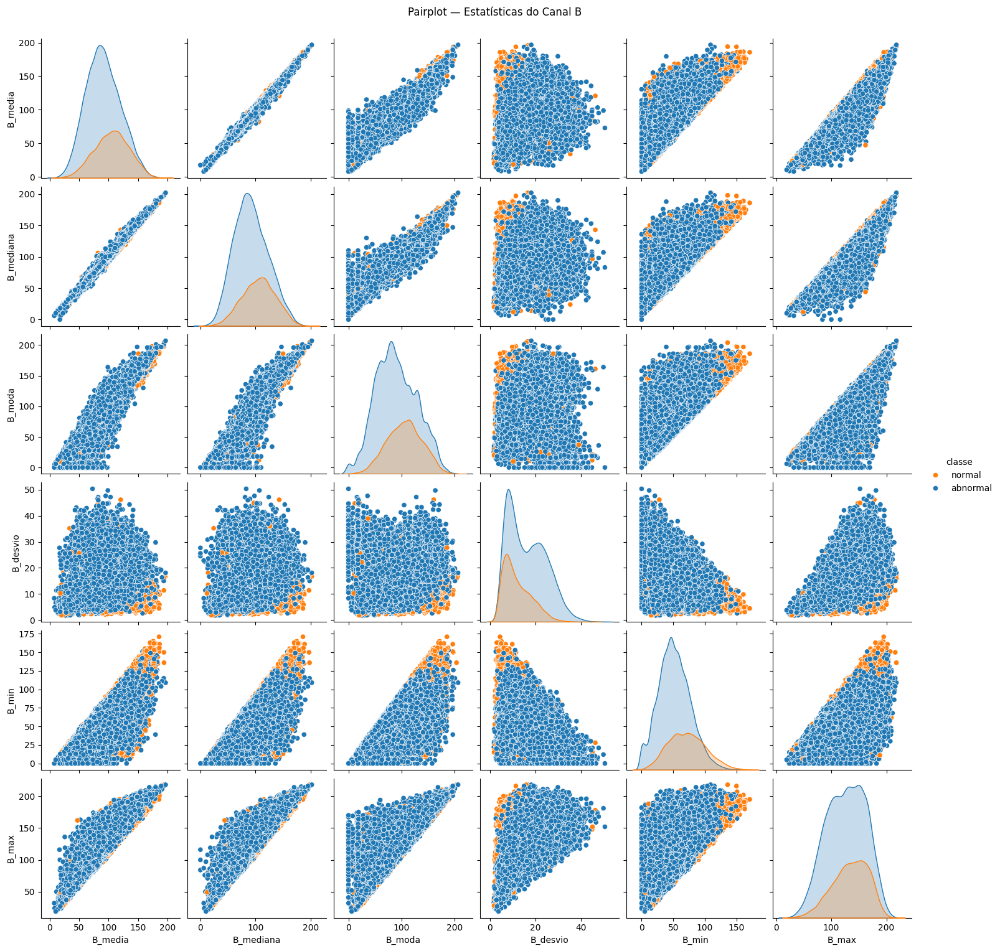

In [ ]:
# Define cores personalizadas
palette = {
    "abnormal": "#1f77b4",  # azul
    "normal": "#ff7f0e"     # laranja
}

# Pairplot com cores invertidas
g = sns.pairplot(
    df_filt,
    vars=['B_media', 'B_mediana', 'B_moda', 'B_desvio', 'B_min', 'B_max'],
    hue='classe',
    palette=palette
)

plt.suptitle("Pairplot — Estatísticas do Canal B", y=1.02)
plt.show()

# Salvar como PNG
g.fig.savefig("pairplot_canal_B.png", dpi=300, bbox_inches='tight')

# Exibir
plt.show()

 Para o canal B, as estatísticas de tendência central não promovem uma separação visual nítida entre as classes nos gráficos de dispersão. Os pontos de anormal se sobrepõem amplamente à distribuição de normal (pode ser explicada pela diferença de quantitativo nos conjuntos para as classes), indicando que ambas compartilham intervalos semelhantes de valores médios. No entanto, os gráficos de densidade revelam diferenças importantes: a classe normal possui distribuições mais simétricas e concentradas, em que quase todas são unicaudal e homogêneas, exceto por variável mínimo (min), que dá a impressão de ser bicaudal. Já anormal, mostra distribuição mais dispersa e assimétrica, com múltiplos picos, o que pode indicar variação estrutural intra-classe. Embora anormal alcance valores mais altos de intensidade azul, a separação não é acentuada nos pares de variáveis, reforçando que essas estatísticas devem ser complementadas por outras métricas para melhor diferenciação entre as classes.

# EDA - features intensidade e espectral

In [ ]:
df_ad = pd.read_csv('/content/drive/MyDrive/RESULTADOS/EDA/features/ARQUIVOS_UNIDOS_REDUCAO/f_unif_AD.csv')
# colunas para serem excluidas
colunas_exc = ['hu1', 'hu2', 'hu3', 'hu4', 'hu5',
       'hu6', 'hu7', 'orientacao', 'euler_number', 'compacidade_topologica',
       'fourier_descritor_medio']
df_ad = df_ad.drop(columns=colunas_exc)
print(df_ad.columns)
print(df_ad.shape)

Index(['subset', 'classe', 'nome_imagem', 'intensidade_sinal_R',
       'intensidade_fundo_R', 'relacao_sinal_fundo_R', 'textura_borda_R',
       'intensidade_sinal_G', 'intensidade_fundo_G', 'relacao_sinal_fundo_G',
       'textura_borda_G', 'intensidade_sinal_B', 'intensidade_fundo_B',
       'relacao_sinal_fundo_B', 'textura_borda_B'],
      dtype='object')
(65521, 15)


In [ ]:
# Filtrar dataset para apenas classes Normal e Abnormal
df_filt = df_ad[df_ad['classe'].isin(['normal', 'abnormal'])]
print(df_filt.shape)

(31025, 15)


In [ ]:
import pandas as pd
import plotly.express as px

# Lista das variáveis que você deseja plotar
variaveis = [
    'intensidade_sinal_R', 'intensidade_fundo_R', 'textura_borda_R',
    'intensidade_sinal_G', 'intensidade_fundo_G', 'textura_borda_G',
    'intensidade_sinal_B', 'intensidade_fundo_B', 'textura_borda_B'
]

# Derretendo o DataFrame no formato longo
df_long = df_filt.melt(
    id_vars='subset',
    value_vars=variaveis,
    var_name='Variável',
    value_name='Valor'
)

# Criando o boxplot geral
fig = px.box(
    df_long,
    x='Variável',
    y='Valor',
    color='subset',
    template='plotly_white',
    title='Boxplot Geral das Variáveis por Dataset',
    points='outliers'  # ou 'outliers'
)

# Ajustes estéticos
fig.update_layout(
    xaxis_title='Variáveis',
    yaxis_title='Valor',
    height=600,
    width=950,
    boxmode='group'
)

fig.show()


In [ ]:
df_filt.describe().T

,count,mean,std,min,25%,50%,75%,max
intensidade_sinal_R,31025.0,94.738916,29.806531,7.937356,73.047512,93.461668,115.710520,196.750160
intensidade_fundo_R,31025.0,144.050140,41.476613,19.133142,112.321229,145.528358,178.346175,231.356405
relacao_sinal_fundo_R,31025.0,0.666605,0.126634,0.099782,0.586469,0.680768,0.759349,0.974078
textura_borda_R,31025.0,119.648299,33.395913,14.695955,95.181818,121.202312,145.631796,211.575085
intensidade_sinal_G,31025.0,63.449863,34.803717,0.089947,37.492677,59.932274,86.691014,184.279393
intensidade_fundo_G,31025.0,122.268570,49.807968,0.258698,83.258457,123.646791,164.730340,220.340048
relacao_sinal_fundo_G,31025.0,0.500775,0.168941,0.016448,0.390983,0.512662,0.626998,0.939640
textura_borda_G,31025.0,93.059054,40.755633,0.091603,62.038462,92.867584,124.605911,196.228228
intensidade_sinal_B,31025.0,65.838608,38.950213,0.217265,35.511111,59.396571,91.304333,194.536450
intensidade_fundo_B,31025.0,120.865080,47.827857,0.451894,83.555556,123.981707,161.278941,210.186445


As estatísticas demonstram que, em todos os canais, os núcleos (região do sinal) tendem a ser menos intensos do que o fundo, favorecendo o contraste. O canal vermelho (R) apresenta o maior contraste médio e também a maior textura de borda, o que pode indicar maior detalhamento ou ruído. O canal verde (G) possui valores mais uniformes, com menor variação textural, o que pode indicar boa estabilidade para segmentações. Já o canal azul (B) se mantém intermediário em intensidade e contraste. Essas observações são úteis para decidir quais canais priorizar em tarefas de segmentação ou classificação baseadas em cor e textura.

In [ ]:
# Análise variáveis sinais
# Transformar o DataFrame para formato longo
df_long = df_filt.melt(
    id_vars=["classe"],
    value_vars=["intensidade_sinal_R", "intensidade_sinal_G", "intensidade_sinal_B"],
    var_name="Canal",
    value_name="Intensidade"
)

# Ajustar os nomes dos canais
df_long["Canal"] = df_long["Canal"].str.replace("intensidade_sinal_", "")

# Criar o violin plot
fig = px.violin(df_long, x="classe", y="Intensidade", color="Canal",
                box=True,  # inclui boxplot dentro do violino
                color_discrete_map={'R': 'red', 'G': 'green', 'B': 'blue'},
                #points="all",  # opcional: exibe os pontos individuais
                title="Violin Plot das Intensidades de Sinal (R, G, B) por Classe",
                labels={"classe": "Classe", "Intensidade": "Intensidade de Sinal"},
                width=800,
                height=400)

fig.show()


In [ ]:
# Tabela auxílio
import pandas as pd

# Lista com colunas a analisar
colunas = ['intensidade_sinal_R', 'intensidade_sinal_G', 'intensidade_sinal_B']
colunas_formatadas = ['R', 'G', 'B']

# Lista para armazenar os resultados
estatisticas = []

# Calcular estatísticas por classe e canal
for col, canal in zip(colunas, colunas_formatadas):
    for classe in df_filt['classe'].unique():
        dados = df_filt[df_filt['classe'] == classe][col].dropna()
        estatisticas.append({
            'Canal': canal,
            'Classe': classe,
            'Min': round(dados.min(), 2),
            'Q1 (25%)': round(dados.quantile(0.25), 2),
            'Mediana': round(dados.median(), 2),
            'Média': round(dados.mean(), 2),
            'Q3 (75%)': round(dados.quantile(0.75), 2),
            'Max': round(dados.max(), 2),
            'Desvio Padrão': round(dados.std(), 2)
        })

# Criar DataFrame
df_estat = pd.DataFrame(estatisticas)

df_estat.head()

,Canal,Classe,Min,Q1 (25%),Mediana,Média,Q3 (75%),Max,Desvio Padrão
0,R,abnormal,7.94,69.81,89.37,90.94,110.93,196.75,29.13
1,R,normal,16.49,85.12,106.00,105.16,125.79,195.94,29.16
2,G,abnormal,0.09,31.46,51.58,54.82,75.47,171.76,31.17
3,G,normal,0.34,62.14,84.57,87.14,110.75,184.28,33.21
4,B,abnormal,0.22,31.55,51.53,56.15,78.33,179.91,32.33


Analisando as características de sinal, apresentada pelo gráfico violinplot e boxplot e tabela complementar, pode-se compreender melhor como é o comportamento das intensidades da área segmentada. Essas informações revelam que a intensidade de sinal nos canais R (vermelho), G (verde) e B (azul), discriminada por classe celular (normal e anormal), apresentam diferenças expressivas entre os grupos. As células da classe normal apresentaram maiores valores médios e medianos em todos os canais em comparação às células anormais, com destaque para o canal azul (B), cuja média foi de 92,4 para a classe normal e 56,1 para a classe anormal. Essa diferença também é reforçada pelos quartis (Q1 e Q3) e pelos valores máximos observados. O gráfico em formato de violino complementa essa análise ao ilustrar a distribuição completa das intensidades, evidenciando uma maior concentração e alargamento das curvas para a classe normal. Além disso, nota-se que as distribuições são assimétricas e com presença de outliers, principalmente para a classe anormal.

In [ ]:
# Identificar variações entre as intensidades de sinal- Quão mais intenso o sinal no canal R é comparado ao G
import numpy as np
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from scipy import stats # Import the stats module

# Criar variáveis de diferença
df_filt.loc[:, 'dif_int_sinal_R_G'] = df_filt['intensidade_sinal_R'] - df_filt['intensidade_sinal_G']
df_filt.loc[:, 'dif_int_sinal_R_B'] = df_filt['intensidade_sinal_R'] - df_filt['intensidade_sinal_B']
df_filt.loc[:, 'dif_int_sinal_G_B'] = df_filt['intensidade_sinal_G'] - df_filt['intensidade_sinal_B']

# Cores fixas para cada classe

cores = {'normal': '#D2691E', 'abnormal': '#4169E1'}
# Subplots lado a lado
fig = make_subplots(rows=1, cols=3, subplot_titles=[
    "Diferença de Sinal - Canal RG",
    "Diferença de Sinal - Canal RB",
    "Diferença de Sinal - Canal GB"
])

variaveis = ['dif_int_sinal_R_G', 'dif_int_sinal_R_B', 'dif_int_sinal_G_B']
classes = df_filt['classe'].unique()

for i, var in enumerate(variaveis):
    for classe in classes:
        valores = df_filt[df_filt['classe'] == classe][var].dropna()
        kde = stats.gaussian_kde(valores)
        x_vals = np.linspace(valores.min(), valores.max(), 200)
        y_vals = kde(x_vals)

        fig.add_trace(
            go.Scatter(
                x=x_vals,
                y=y_vals,
                mode='lines',
                name=classe,
                legendgroup=classe,
                fill='tozeroy',
                line=dict(color=cores[classe]),
                opacity=0.4,
                showlegend=(i == 0)
            ),
            row=1, col=i+1
        )

# Layout final
fig.update_layout(
    height=450,
    width=900,
    title="Distribuição KDE - Diferença de Sinal por Canal",
    legend_title_text="Classe",
    legend=dict(groupclick="togglegroup")
)

# Eixos
for i in range(1, 4):
    fig.update_xaxes(title_text="Diferença", row=1, col=i)
    fig.update_yaxes(title_text="Densidade", row=1, col=i)

fig.show()

Essas variáveis foram calculadas para investigar melhor o comportamento da intensidade da área segmentada. Ela apresenta a distribuição dessas diferenças, utilizando curvas de densidade estimada (KDE plots), destacando padrões distintos de coloração entre as classes e reforçando o potencial diagnóstico desses atributos derivados. A análise das distribuições KDE preenchidas para as diferenças de intensidade entre os canais de cor (R e G, R e B, G e B) revelou comportamentos cromáticos distintos entre as classes normal e anormal. Para diferença entre R e G (diferença entre vermelho e verde), a classe anormal apresentou distribuição mais concentrada, com pico em torno de 40, indicando predominância consistente do vermelho sobre o verde. Em contraste, a classe normal mostrou distribuição mais dispersa, com cauda à esquerda, refletindo maior variabilidade nessa diferença. Já diferença para canais R e B (vermelho menos azul), a classe anormal novamente exibiu um pico bem definido próximo de 45, reforçando a dominância do vermelho, enquanto a classe normal apresentou maior dispersão e valores negativos em alguns casos, o que sugere presença de azul mais intenso que vermelho em determinadas imagens. E, para diferença entre canais G e B (verde menos azul), a classe normal apresentou distribuição bimodal, indicando subgrupos com diferentes padrões cromáticos, ao passo que, a classe anormal manteve distribuição unimodal com pico ao redor de 15, refletindo predominância leve do verde sobre o azul.

In [ ]:
# Criar índices espectrais (razões entre intensidades de sinal)
df_filt['indice_sinal_R_G'] = df_filt['intensidade_sinal_R'] / df_filt['intensidade_sinal_G']
df_filt['indice_sinal_R_B'] = df_filt['intensidade_sinal_R'] / df_filt['intensidade_sinal_B']
df_filt['indice_sinal_G_B'] = df_filt['intensidade_sinal_G'] / df_filt['intensidade_sinal_B']

# Calcular média e desvio padrão das diferenças por classe
resumo_dif = df_filt.groupby("classe")[["indice_sinal_R_G", "indice_sinal_R_B", "indice_sinal_G_B"]].agg(['mean', 'std'])
resumo_dif.columns = ['_'.join(col) for col in resumo_dif.columns]
resumo_dif = resumo_dif.reset_index()

# Criar gráfico de barras com erro (diferenças entre canais de fundo)
fig = go.Figure()

difs = ['R-G', 'R-B', 'G-B']
variaveis = ['indice_sinal_R_G', 'indice_sinal_R_B', 'indice_sinal_G_B']
cores = ['orange', 'purple', 'teal']

for var, label, cor in zip(variaveis, difs, cores):
    fig.add_trace(go.Bar(
        name=f'Diferença {label}',
        x=resumo_dif['classe'],
        y=resumo_dif[f'{var}_mean'],
        error_y=dict(type='data', array=resumo_dif[f'{var}_std']),
        marker_color=cor
    ))

fig.update_layout(
    barmode='group',
    title="Indice entre Intensidades de Sinal por Classe (Média ± Desvio Padrão)",
    xaxis_title="Classe",
    yaxis_title="Indice de Intensidade",
    legend_title="Canal Comparado",
    width=600,
    height=400
)

fig.show()

/tmp/ipython-input-1659976452.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipython-input-1659976452.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipython-input-1659976452.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
resumo_dif = resumo_dif.reset_index()
resumo_dif.head()


,index,classe,dif_fundo_R_G_mean,dif_fundo_R_G_std,dif_fundo_R_B_mean,dif_fundo_R_B_std,dif_fundo_G_B_mean,dif_fundo_G_B_std
0,0,abnormal,25.554149,20.632963,28.118671,15.821717,2.564521,26.091022
1,1,normal,11.428604,23.041463,9.645913,28.808413,-1.782691,44.849425


Além das diferenças de intensidades entre os canais, calculou-s três novas variáveis correspondentes aos índices de intensidade de sinal entre os canais de cor R, G e B. Essas variáveis foram obtidas por meio das razões entre os canais: R/G, R/B e G/B.

As distribuições dessas variáveis podem ser visualizadas no plot e tabela resumo. Com isso, as diferenças de intensidade de fundo entre canais são maiores em média na classe anormal, indicando que essas amostras tendem a ter uma coloração mais assimétrica (maior contraste entre canais). No entanto, os altos desvios padrão em anormal sugerem grande heterogeneidade na coloração de fundo, o que pode refletir ruído, variações de preparação das lâminas ou características intrínsecas das imagens. A classe normal apresenta distribuições mais centradas e com menor variação, sugerindo padrões cromáticos de fundo mais consistentes.

In [ ]:
# Análise variáveis sinais
# Transformar o DataFrame para formato longo
df_long = df_filt.melt(
    id_vars=["classe"],
    value_vars=["intensidade_fundo_R", "intensidade_fundo_G", "intensidade_fundo_B"],
    var_name="Canal",
    value_name="Intensidade"
)

# Ajustar os nomes dos canais
df_long["Canal"] = df_long["Canal"].str.replace("intensidade_fundo_", "")

# Criar o violin plot
fig = px.violin(df_long, x="classe", y="Intensidade", color="Canal",
                box=True,  # inclui boxplot dentro do violino
                color_discrete_map={'R': 'red', 'G': 'green', 'B': 'blue'},
                #points="all",  # opcional: exibe os pontos individuais
                title="Violin Plot das Intensidades de Fundo (R, G, B) por Classe",
                labels={"classe": "Classe", "Intensidade": "Intensidade de Fundo"},
                width=800,
                height=400)

fig.show()


In [ ]:
# Tabela auxílio

# Lista com colunas a analisar
colunas = ['intensidade_fundo_R', 'intensidade_fundo_G', 'intensidade_fundo_B']
colunas_formatadas = ['R', 'G', 'B']

# Lista para armazenar os resultados
estatisticas = []

# Calcular estatísticas por classe e canal
for col, canal in zip(colunas, colunas_formatadas):
    for classe in df_filt['classe'].unique():
        dados = df_filt[df_filt['classe'] == classe][col].dropna()
        estatisticas.append({
            'Canal': canal,
            'Classe': classe,
            'Min': round(dados.min(), 2),
            'Q1 (25%)': round(dados.quantile(0.25), 2),
            'Mediana': round(dados.median(), 2),
            'Média': round(dados.mean(), 2),
            'Q3 (75%)': round(dados.quantile(0.75), 2),
            'Max': round(dados.max(), 2),
            'Desvio Padrão': round(dados.std(), 2)
        })

# Criar DataFrame
df_estat_2 = pd.DataFrame(estatisticas)

df_estat_2.head()

,Canal,Classe,Min,Q1 (25%),Mediana,Média,Q3 (75%),Max,Desvio Padrão
0,R,abnormal,19.13,110.52,144.59,143.29,178.39,231.36,42.33
1,R,normal,25.71,118.00,147.72,146.14,178.28,228.45,38.96
2,G,abnormal,0.26,76.76,117.21,117.73,161.33,220.34,51.20
3,G,normal,6.96,101.23,136.75,134.71,171.57,216.67,43.41
4,B,abnormal,0.45,79.18,114.72,115.17,154.04,210.19,47.23


Apresenta as distribuições das intensidades médias do fundo por classe, por meio da análise descritiva das intensidades de fundo nos canais R, G e B revelou diferenças sutis entre as classes normal e anormal. De modo geral, a classe normal apresentou médias mais elevadas em todos os canais, quando comparada à classe anormal. Essa tendência também foi observada nas medianas e nos quartis superiores (Q3), indicando um fundo mais iluminado nas imagens da classe normal. No entanto, os elevados desvios padrão (variando entre 39,0 e 51,2) sugerem uma grande dispersão dos valores de intensidade em ambas as classes, refletindo uma considerável heterogeneidade no fundo das imagens.


In [ ]:
# 1. Limpeza dos dados
df_filt['classe'] = df_filt['classe'].astype(str).str.strip()

# Subplots lado a lado
fig = make_subplots(rows=1, cols=3, subplot_titles=[
    "Textura de Borda - Canal R",
    "Textura de Borda - Canal G",
    "Textura de Borda - Canal B"
])

# Cores fixas para cada classe
cores = {'normal': '#D2691E', 'abnormal': '#4169E1'}

variaveis = ['textura_borda_R', 'textura_borda_G', 'textura_borda_B']
classes = df_filt['classe'].unique()

for i, var in enumerate(variaveis):
    for classe in classes:
        valores = df_filt[df_filt['classe'] == classe][var].dropna()
        kde = stats.gaussian_kde(valores)
        x_vals = np.linspace(valores.min(), valores.max(), 200)
        y_vals = kde(x_vals)

        fig.add_trace(
            go.Scatter(
                x=x_vals,
                y=y_vals,
                mode='lines',
                name=classe,
                legendgroup=classe,
                fill='tozeroy',
                line=dict(color=cores[classe]),
                opacity=0.4,
                showlegend=(i == 0)
            ),
            row=1, col=i+1
        )

# Layout final com controle global da legenda
fig.update_layout(
    height=450,
    width=950,
    title="Distribuição KDE - Textura de Borda por Canal",
    legend_title_text="Classe",
    legend=dict(groupclick="togglegroup")  # <-- ESSENCIAL para aplicar nos três ao mesmo tempo
)

for i in range(1, 4):
    fig.update_xaxes(title_text="Textura de Borda", row=1, col=i)
    fig.update_yaxes(title_text="Densidade", row=1, col=i)

fig.show()


/tmp/ipython-input-884848228.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



A análise da textura de borda nos canais R, G e B revelou diferenças perceptíveis na distribuição das intensidades entre as classes normal e anormal. De forma geral, a classe anormal apresentou um deslocamento das curvas de densidade para valores mais baixos de textura nos canais, indicando menor complexidade textural nas bordas das regiões segmentadas. Em contrapartida, a classe normal demonstrou uma distribuição mais concentrada em valores médios a altos de textura de borda, sugerindo uma maior variação de intensidade nas transições entre as regiões segmentadas e o fundo. Essa diferença entre as classes pode estar relacionada a características morfológicas e estruturais distintas dos núcleos celulares.

In [ ]:
# Criar cópia do DataFrame para calcular diferenças e índices de textura simuladas

# Calcular diferenças entre canais
df_filt['dif_textura_RG'] = df_filt['textura_borda_R'] - df_filt['textura_borda_G']
df_filt['dif_textura_GB'] = df_filt['textura_borda_G'] - df_filt['textura_borda_B']
df_filt['dif_textura_RB'] = df_filt['textura_borda_R'] - df_filt['textura_borda_B']

# Calcular índices (razões) entre canais, com pequeno epsilon para evitar divisão por zero
eps = 1e-5
df_filt['indice_textura_RG'] = df_filt['textura_borda_R'] / (df_filt['textura_borda_G'] + eps)
df_filt['indice_textura_GB'] = df_filt['textura_borda_G'] / (df_filt['textura_borda_B'] + eps)
df_filt['indice_textura_RB'] = df_filt['textura_borda_R'] / (df_filt['textura_borda_B'] + eps)

/tmp/ipython-input-3988633691.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipython-input-3988633691.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipython-input-3988633691.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipython-input-398

In [ ]:
# Calcular média e desvio padrão por classe
resumo_tb = df_filt.groupby("classe")[[
    'dif_textura_RG', 'dif_textura_GB', 'dif_textura_RB']].agg(['mean', 'std'])
resumo_tb.columns = ['_'.join(col) for col in resumo_tb.columns]
resumo_tb = resumo_tb.reset_index()

# Gráfico
variaveis = ['dif_textura_RG', 'dif_textura_GB', 'dif_textura_RB']
cores = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b']

fig = go.Figure()
for var, cor in zip(variaveis, cores):
    fig.add_trace(go.Bar(
        name=var,
        x=resumo_tb['classe'],
        y=resumo_tb[f'{var}_mean'],
        error_y=dict(type='data', array=resumo_tb[f'{var}_std']),
        marker_color=cor
    ))

fig.update_layout(
    barmode='group',
    title="Média ± Desvio Padrão — Diferenças de Textura de Bordas entre Canais",
    xaxis_title="Classe",
    yaxis_title="Valor",
    legend_title="Variável Comparada",
    template="plotly_white",
    height=400,
    width=800
)

fig.show()


In [ ]:
# Exportar para LaTeX
resumo_tb.head()

,classe,dif_textura_RG_mean,dif_textura_RG_std,dif_textura_GB_mean,dif_textura_GB_std,dif_textura_RB_mean,dif_textura_RB_std
0,abnormal,31.182335,20.983298,1.083923,26.742068,32.266259,16.655526
1,normal,13.984577,26.011713,-2.698593,47.858507,11.285984,30.501872


As varíaveis de diferença de textura de bordas para os canais R, G, B, foram calculadas seguindo o mesmo raciocínio das variáveis de intensidade sinal. Essas variáveis podem ser analisadas no gráfico e tabela complementar. A análise das diferenças de textura entre os canais de cor (R e G, G e B e R e B) evidenciou padrões distintos entre as classes anormal e normal. As diferenças R-G e R-B apresentaram as maiores médias na classe anormal (31,2 e 32,3, respectivamente), com desvios padrão relativamente controlados (21,0 e 16,7), indicando um comportamento mais estável e acentuado da textura de borda no canal vermelho em relação aos canais verde e azul. Em contraste, a classe normal apresentou valores médios significativamente menores (14,0 para R-G e 11,3 para R-B), acompanhados de alta variabilidade, especialmente em R-B (±30,50), o que sugere maior heterogeneidade na composição textural de borda dessa classe. Já a diferença entre G e B demonstrou médias próximas de zero para ambas as classes (1,1 em abnormal e –2,70 em normal), mas com altos desvios padrão, especialmente em normal (±47,9), indicando ausência de padrão definido e, portanto, baixo poder discriminativo. Esses resultados sugerem que as diferenças entre R e G e R e B são os mais relevantes para distinguir as classes com base na textura da borda, com destaque para a predominância do canal vermelho nas imagens da classe anormal.

In [ ]:
# Calcular média e desvio padrão por classe
resumo_ind = df_filt.groupby("classe")[['indice_textura_RG', 'indice_textura_GB', 'indice_textura_RB']].agg(['mean', 'std'])
resumo_ind.columns = ['_'.join(col) for col in resumo_ind.columns]
resumo_ind = resumo_ind.reset_index()

# Gráfico
variaveis = ['indice_textura_RG', 'indice_textura_GB', 'indice_textura_RB']
cores = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b']

fig = go.Figure()
for var, cor in zip(variaveis, cores):
    fig.add_trace(go.Bar(
        name=var,
        x=resumo_ind['classe'],
        y=resumo_ind[f'{var}_mean'],
        error_y=dict(type='data', array=resumo_ind[f'{var}_std']),
        marker_color=cor
    ))

fig.update_layout(
    barmode='group',
    title="Média ± Desvio Padrão — Índices de Textura de Bordas entre Canais",
    xaxis_title="Classe",
    yaxis_title="Valor",
    legend_title="Variável Comparada",
    template="plotly_white",
    height=400,
    width=800
)

fig.show()


In [ ]:
# Tabela complementar
resumo_ind.head()

,classe,indice_textura_RG_mean,indice_textura_RG_std,indice_textura_GB_mean,indice_textura_GB_std,indice_textura_RB_mean,indice_textura_RB_std
0,abnormal,1.927491,6.182437,1.261693,2.462474,1.852652,4.264917
1,normal,1.217586,0.482975,1.164492,0.660271,1.241547,0.448848


As distribuições dessas variáveis podem ser visualizadas no gráfico e tabela complentar, para os índices calculados para textura de borda para os canais R, G e B, como calculado para intensidade canal. A avaliação dos índices de textura de bordas entre canais de cor revelou diferenças sutis nas médias entre as classes abnormal e normal, com destaque para a variabilidade interna nos dados da classe anormal. Nos três índices analisados, R e G, G e B, R e B, a classe anormal apresentou valores médios ligeiramente superiores, indicando uma tendência à maior discrepância de textura de bordas entre os canais. No entanto, o aspecto mais relevante foi o alto desvio padrão em anormal, sobretudo no índice R e G para mais ou menos 6,2 e R e B para mais ou menos 4,3, contrastando com a baixa variabilidade da classe normal sendo menor ou igual 0,7 em todos os índices. Isso sugere que, embora a classe normal mantenha uma estrutura textural mais consistente entre os canais, a classe anormal apresenta variação interna acentuada, possivelmente refletindo heterogeneidade morfológica ou técnica.



In [ ]:
# Análise variáveis sinais
# Transformar o DataFrame para formato longo
df_long = df_filt.melt(
    id_vars=["classe"],
    value_vars=['relacao_sinal_fundo_R', 'relacao_sinal_fundo_G', 'relacao_sinal_fundo_B'],
    var_name="Canal",
    value_name="Relação"
)
# Ajustar os nomes dos canais
df_long["Canal"] = df_long["Canal"].str.replace("relacao_sinal_fundo_", "")

# Criar o violin plot
fig = px.violin(df_long, x="classe", y="Relação", color="Canal",
                box=True,  # inclui boxplot dentro do violino
                color_discrete_map={'R': 'red', 'G': 'green', 'B': 'blue'},
                #points="all",  # opcional: exibe os pontos individuais
                title="Violin Plot das relação de Sinal e fundo (R, G, B) por Classe",
                labels={"classe": "Classe", "Intensidade": "Relação Sinal e Fundo"},
                width=800,
                height=400)

fig.show()

In [ ]:
# Tabela auxílio
import pandas as pd

# Supondo que df_final tenha as colunas:
# 'classe', 'intensidade_sinal_r', 'intensidade_sinal_g', 'intensidade_sinal_b'

# Lista com colunas a analisar
colunas = ['relacao_sinal_fundo_R', 'relacao_sinal_fundo_G', 'relacao_sinal_fundo_B']
colunas_formatadas = ['R', 'G', 'B']

# Lista para armazenar os resultados
estatisticas = []

# Calcular estatísticas por classe e canal
for col, canal in zip(colunas, colunas_formatadas):
    for classe in df_filt['classe'].unique():
        dados = df_filt[df_filt['classe'] == classe][col].dropna()
        estatisticas.append({
            'Canal': canal,
            'Classe': classe,
            'Min': round(dados.min(), 2),
            'Q1 (25%)': round(dados.quantile(0.25), 2),
            'Mediana': round(dados.median(), 2),
            'Média': round(dados.mean(), 2),
            'Q3 (75%)': round(dados.quantile(0.75), 2),
            'Max': round(dados.max(), 2),
            'Desvio Padrão': round(dados.std(), 2)
        })

# Criar DataFrame
df_estat_3 = pd.DataFrame(estatisticas)


df_estat_3

,Canal,Classe,Min,Q1 (25%),Mediana,Média,Q3 (75%),Max,Desvio Padrão
0,R,abnormal,0.10,0.57,0.66,0.64,0.73,0.93,0.12
1,R,normal,0.20,0.66,0.75,0.73,0.82,0.97,0.12
2,G,abnormal,0.02,0.35,0.46,0.45,0.56,0.88,0.15
3,G,normal,0.05,0.58,0.66,0.65,0.73,0.94,0.12
4,B,abnormal,0.02,0.36,0.47,0.47,0.58,0.95,0.16
5,B,normal,0.08,0.57,0.69,0.66,0.78,1.08,0.16


A análise da relação entre sinal e fundo nos canais R, G e B revelou diferenças consistentes entre as classes normal e anormal, evidenciadas tanto pelas estatísticas descritivas quanto pela forma das distribuições nos gráficos violin plot. Em todos os canais avaliados, a classe normal apresentou valores médios e medianos mais elevados, indicando que o sinal se destaca mais nitidamente em relação ao fundo. No canal vermelho (R), a classe normal apresentou média de 0,7 e mediana de 0,8, enquanto a classe anormal mostrou valores inferiores (média de 0,6), com distribuição mais dispersa. O canal verde (G) demonstrou a maior capacidade discriminativa, com uma diferença média de 0,20 entre as classes (0,7 em normal vs. 0,5 em anormal), sugerindo que o verde é um canal particularmente relevante para destacar o sinal na classe normal. Já no canal azul (B), embora os valores não estejam integralmente descritos para a classe normal, o gráfico indica uma tendência semelhante, com distribuições mais altas e concentradas em normal do que em anormal.